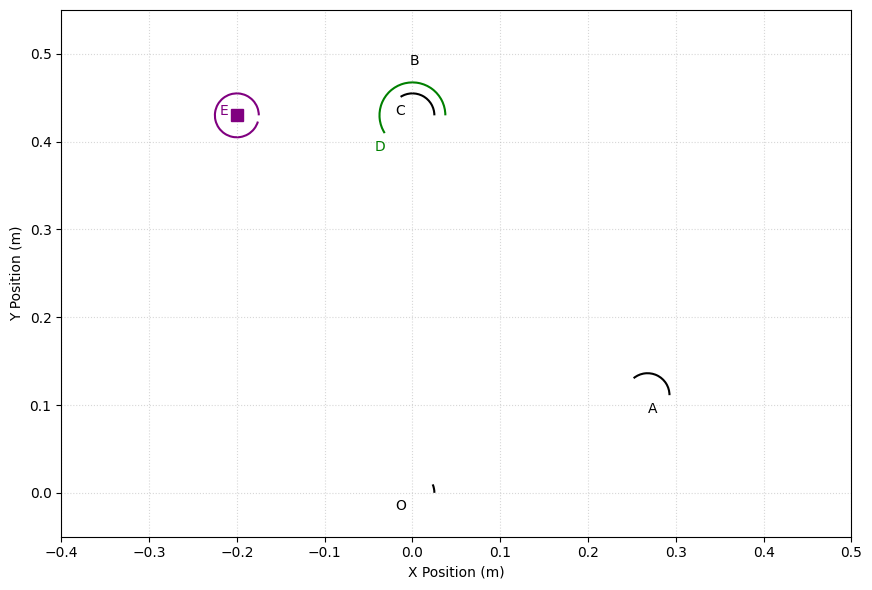

In [18]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Arc
from matplotlib.animation import FuncAnimation
from scipy.interpolate import interp1d
from scipy.integrate import solve_ivp
from IPython.display import HTML

# -----------------------------
# 1. Link lengths & Constants
# -----------------------------
l_1 = 0.29   # m (Input crank)
l_2 = 0.46   # m (Connecting rod)
l_3 = 0.044  # m (Follower/Rocker segment)
l_4 = 0.43   # m (Ground link height)
l_5 = 0.075  # m (Output link segment)

L0 = 0.178   # Spring rest length (m)
ks = 79000   # Spring constant (N/m)

# -----------------------------
# 2. Fixed points & Range
# -----------------------------
O = np.array([0.0, 0.0])
C = np.array([0.0, l_4])
E = np.array([C[0] - 0.2, C[1]])

theta1_range = np.linspace(0, 0.523599, 400) # Input range in radians

# -----------------------------
# 3. Geometry Solver
# -----------------------------
A_list, B_list, D_list = [], [], []

for t1 in theta1_range:
    posA = O + np.array([l_1*np.cos(t1), l_1*np.sin(t1)])
    d = np.linalg.norm(C - posA)

    # Triangle inequality check
    if d > l_2 + l_3 or d < abs(l_2 - l_3):
        continue

    # Law of Cosines approach
    a = (l_2**2 - l_3**2 + d**2) / (2*d)
    h = np.sqrt(max(0, l_2**2 - a**2))
    P = posA + a*(C - posA) / d

    # Point B
    Bx = P[0] + h*(C[1] - posA[1]) / d
    By = P[1] - h*(C[0] - posA[0]) / d
    posB = np.array([Bx, By])

    # Point D (perpendicular to Link 3)
    v3 = C - posB
    v3_hat = v3 / np.linalg.norm(v3)
    n_hat = np.array([v3_hat[1], -v3_hat[0]])
    posD = C + l_5 * n_hat

    A_list.append(posA)
    B_list.append(posB)
    D_list.append(posD)

A = np.array(A_list)
B = np.array(B_list)
D = np.array(D_list)

# -----------------------------
# 4. Kinematics & Forces
# -----------------------------
spring_len = np.linalg.norm(D - E, axis=1) - 0.01905
Fs = ks * (L0 - spring_len)

def angle_deg(p1, p2):
    v = p2 - p1
    return np.degrees(np.arctan2(v[1], v[0]))

th1_arr = np.array([angle_deg(O, p) for p in A])
th2_arr = np.array([angle_deg(A[i], B[i]) for i in range(len(A))])
th3_arr = np.array([angle_deg(C, B[i]) for i in range(len(B))])
th4_arr = np.array([angle_deg(C, D[i]) for i in range(len(D))])
th5_arr = np.array([angle_deg(E, D[i]) for i in range(len(D))])

# -----------------------------
# 5. Animation Setup
# -----------------------------
# Adjusted figsize to 12x6 to make the plot wider
fig, ax = plt.subplots(figsize=(10, 6))
ax.set_aspect('equal')

# Expanded x-limits and kept y-limits tight
ax.set_xlim(-0.4, 0.5)
ax.set_ylim(-0.05, 0.55)
ax.grid(True, linestyle=':', alpha=0.5)

ax.set_xlabel('X Position (m)')
ax.set_ylabel('Y Position (m)')

link,   = ax.plot([], [], lw=3, color='#1f77b4', zorder=2)
link5,  = ax.plot([], [], lw=3, color='green', zorder=2)
spring, = ax.plot([], [], lw=3, color='purple', zorder=2)
traceD, = ax.plot([], [], lw=1, linestyle='--', color='green', alpha=0.4)
joints, = ax.plot([], [], 'o', color='black', markersize=6, zorder=3)
target, = ax.plot(E[0], E[1], 's', color='purple', markersize=8)

arc_r = 0.05
arc1 = Arc(O, arc_r, arc_r, theta1=0, theta2=0, color='black', lw=1.5)
arc2 = Arc(A[0], arc_r, arc_r, theta1=0, theta2=0, color='black', lw=1.5)
arc3 = Arc(C, arc_r, arc_r, theta1=0, theta2=0, color='black', lw=1.5)
arc4 = Arc(C, arc_r*1.5, arc_r*1.5, theta1=0, theta2=0, color='green', lw=1.5)
arc5 = Arc(E, arc_r, arc_r, theta1=0, theta2=0, color='purple', lw=1.5)

for a_patch in [arc1, arc2, arc3, arc4, arc5]:
    ax.add_patch(a_patch)

angle_text = ax.text(0.02, 0.95, "", transform=ax.transAxes, va='top', 
                     family="monospace", fontsize=10, bbox=dict(facecolor='white', alpha=0.8))

traceDx, traceDy = [], []

def init():
    link.set_data([], [])
    link5.set_data([], [])
    spring.set_data([], [])
    traceD.set_data([], [])
    joints.set_data([], [])
    angle_text.set_text("")
    return link, link5, spring, traceD, joints, arc1, arc2, arc3, arc4, arc5, angle_text

def update(i):
    # Update Links
    link.set_data([O[0], A[i,0], B[i,0], C[0], O[0]], [O[1], A[i,1], B[i,1], C[1], O[1]])
    link5.set_data([C[0], D[i,0]], [C[1], D[i,1]])
    spring.set_data([D[i,0], E[0]], [D[i,1], E[1]])

    # Update Traces
    traceDx.append(D[i,0]); traceDy.append(D[i,1])
    traceD.set_data(traceDx, traceDy)

    # Update Joints
    joints.set_data([A[i,0], B[i,0], C[0], D[i,0]], [A[i,1], B[i,1], C[1], D[i,1]])

    # Update Arcs
    arc1.center = O; arc1.theta2 = th1_arr[i]
    arc2.center = A[i]; arc2.theta2 = th2_arr[i]
    arc3.center = C; arc3.theta2 = th3_arr[i]
    arc4.center = C; arc4.theta2 = th4_arr[i]
    arc5.center = E; arc5.theta2 = th5_arr[i]

    angle_text.set_text(
        f"θ1: {th1_arr[i]:6.2f}°\nθ2: {th2_arr[i]:6.2f}°\n"
        f"θ3: {th3_arr[i]:6.2f}°\nθ4: {th4_arr[i]:6.2f}°\n"
        f"θ5: {th5_arr[i]:6.2f}°\nFs: {Fs[i]:6.2f} N"
    )

    for t in ax.texts[1:]: t.remove()

    off = 0.02
    ax.text(O[0]-off, O[1]-off, 'O')
    ax.text(A[i,0], A[i,1]-off, 'A')
    ax.text(B[i,0]+off, B[i,1]+off, 'B')
    ax.text(C[0]-off, C[1], 'C')
    ax.text(D[i,0]+off, D[i,1], 'D', color='green')
    ax.text(E[0]-off, E[1], 'E', color='purple')

    return link, link5, spring, traceD, joints, arc1, arc2, arc3, arc4, arc5, angle_text

plt.tight_layout()

ani = FuncAnimation(fig, update, frames=len(A), init_func=init, interval=30, blit=False)

# --- ADDED CODE TO EXPORT GIF ---
# This saves the GIF to your current directory. 
# Requires the 'pillow' library (pip install pillow)
ani.save('four_bar_linkage.gif', writer='pillow', fps=30, dpi=100)

# Still display the JSHTML for notebook viewing
HTML(ani.to_jshtml())